## Importing Libraries

In [52]:
import pandas as pd
import numpy as np
import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt

from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.metrics import r2_score, mean_squared_error
from sklearn.ensemble import RandomForestRegressor
from sklearn.pipeline import make_pipeline
from sklearn.svm import SVR

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping
!pip install tensorflow

## Loading Data

This classic dataset contains the prices and other attributes of almost 54,000 diamonds. There are 11 attributes included in the dataset including the target price.
                  Feature description:      
-Price         
price in US dollars ($326--$18,823)This is the target column containing tags for the features.         
-Carat        
(0.2--5.01) The carat is the diamond’s physical weight measured in metric carats.  One carat equals 1/5 gram and is subdivided into 100 points. Carat weight is the most objective grade of the 4Cs.       
-Cut     
(Fair, Good, Very Good, Premium, Ideal) In determining the quality of the cut, the diamond grader evaluates the cutter’s skill in the fashioning of the diamond. The more precise the diamond is cut, the more captivating the diamond is to the eye.       
-Color       
from J (worst) to D (best) The colour of gem-quality diamonds occurs in many hues. In the range from colourless to light yellow or light brown. Colourless diamonds are the rarest. Other natural colours (blue, red, pink for example) are known as "fancy,” and their colour grading is different than from white colorless diamonds.           
-Clarity         
(I1 (worst), SI2, SI1, VS2, VS1, VVS2, VVS1, IF (best)) Diamonds can have internal characteristics known as inclusions or external characteristics known as blemishes. Diamonds without inclusions or blemishes are rare; however, most characteristics can only be seen with magnification.           
-Dimensions        
x length in mm (0--10.74)         
y width in mm (0--58.9)        
z depth in mm (0--31.8)        

In [55]:
df = pd.read_csv('/Users/kutaler/Downloads/diamonds.csv')

In [57]:
df.head()

,Unnamed: 0,carat,cut,color,clarity,depth,table,price,x,y,z
0,1,0.23,Ideal,E,SI2,61.5,55.0,326,3.95,3.98,2.43
1,2,0.21,Premium,E,SI1,59.8,61.0,326,3.89,3.84,2.31
2,3,0.23,Good,E,VS1,56.9,65.0,327,4.05,4.07,2.31
3,4,0.29,Premium,I,VS2,62.4,58.0,334,4.20,4.23,2.63
4,5,0.31,Good,J,SI2,63.3,58.0,335,4.34,4.35,2.75


In [59]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 53940 entries, 0 to 53939
Data columns (total 11 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Unnamed: 0  53940 non-null  int64  
 1   carat       53940 non-null  float64
 2   cut         53940 non-null  object 
 3   color       53940 non-null  object 
 4   clarity     53940 non-null  object 
 5   depth       53940 non-null  float64
 6   table       53940 non-null  float64
 7   price       53940 non-null  int64  
 8   x           53940 non-null  float64
 9   y           53940 non-null  float64
 10  z           53940 non-null  float64
dtypes: float64(6), int64(2), object(3)
memory usage: 4.5+ MB


In [61]:
df.describe()

,Unnamed: 0,carat,depth,table,price,x,y,z
count,53940.000000,53940.000000,53940.000000,53940.000000,53940.000000,53940.000000,53940.000000,53940.000000
mean,26970.500000,0.797940,61.749405,57.457184,3932.799722,5.731157,5.734526,3.538734
std,15571.281097,0.474011,1.432621,2.234491,3989.439738,1.121761,1.142135,0.705699
min,1.000000,0.200000,43.000000,43.000000,326.000000,0.000000,0.000000,0.000000
25%,13485.750000,0.400000,61.000000,56.000000,950.000000,4.710000,4.720000,2.910000
50%,26970.500000,0.700000,61.800000,57.000000,2401.000000,5.700000,5.710000,3.530000
75%,40455.250000,1.040000,62.500000,59.000000,5324.250000,6.540000,6.540000,4.040000
max,53940.000000,5.010000,79.000000,95.000000,18823.000000,10.740000,58.900000,31.800000


### Data Preprocessing

Steps involved in Data Preprocessing       
-Data cleaning        
-Identifying and removing outliers       
-Encoding categorical variables      

In [65]:
df = df.drop(["Unnamed: 0"], axis=1)

The first column is an index ("Unnamed: 0") and this we are going to remove it.


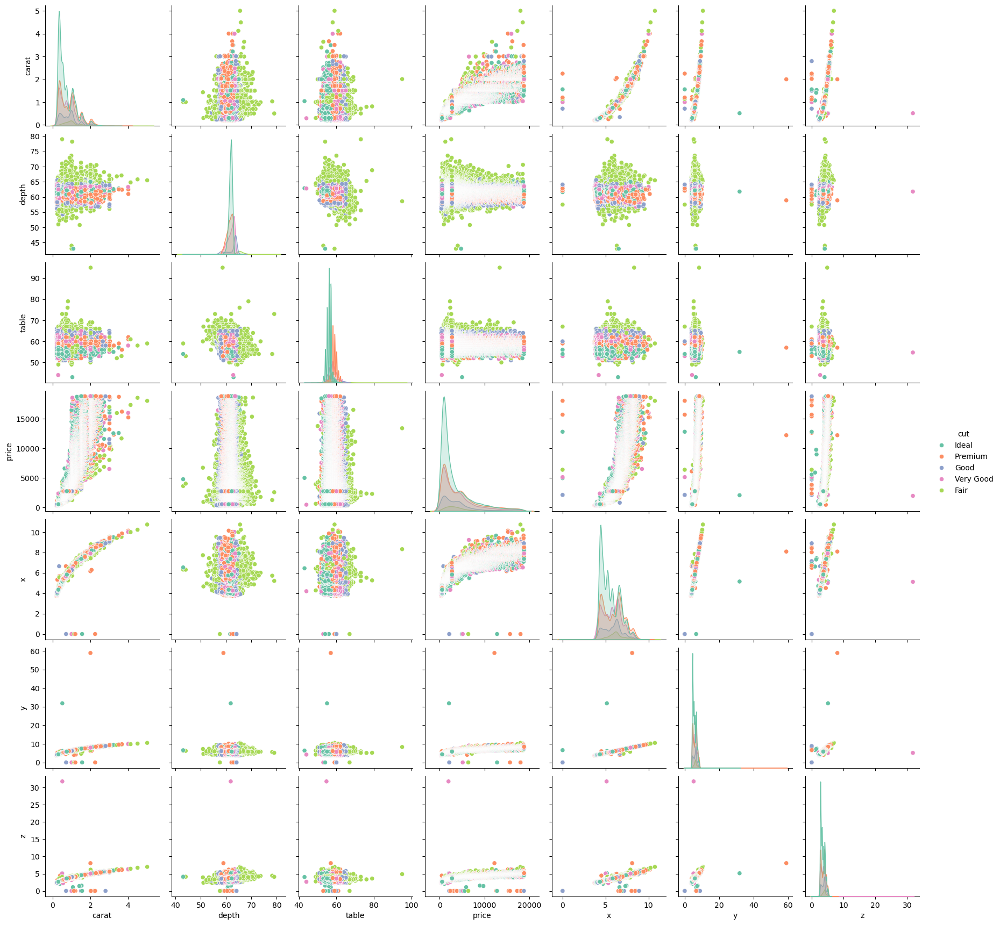

In [69]:
df_pair = sns.pairplot(df, hue="cut", palette="Set2")

### Pairplot Of Data

A few points to notice in these pair plots       

There are some features with datapoint that are far from the rest of the dataset which will affect the outcome of our regression model.  

- Min value of "x", "y", "z" are zero this indicates that there are faulty values in data that represents dimensionless or 2-dimensional diamonds. So we need to filter out those as it clearly faulty data points.       
- The "depth" should be capped but we must examine the regression line to be sure.         
- The "table" featured should be capped too.         
- Let's have a look at regression plots to get a close look at the outliers.       

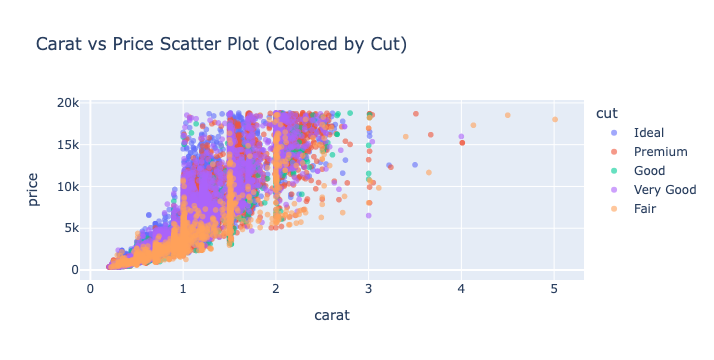

In [71]:
# Carat vs Price Scatter Plot (Colored by Cut)
fig = px.scatter(df,
                 x="carat",
                 y="price",
                 color="cut",
                 hover_data=["color", "clarity"],
                 title="Carat vs Price Scatter Plot (Colored by Cut)",
                 opacity=0.6)
fig.show()

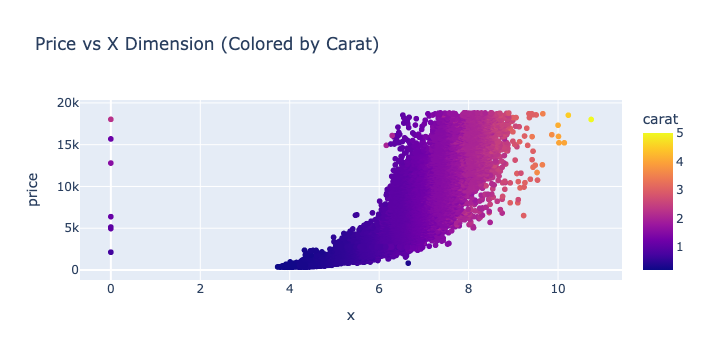

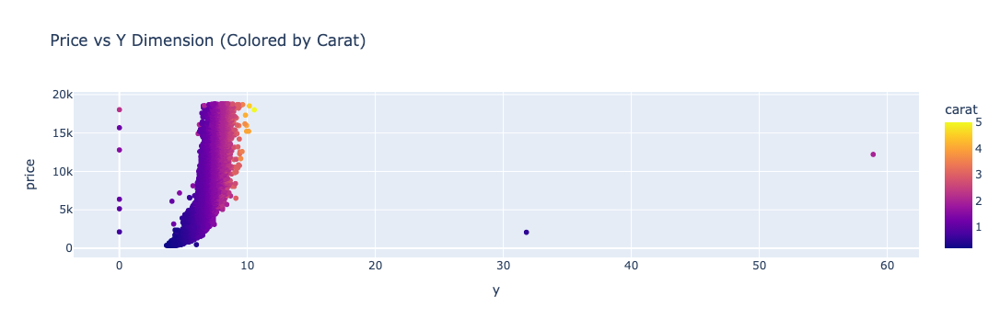

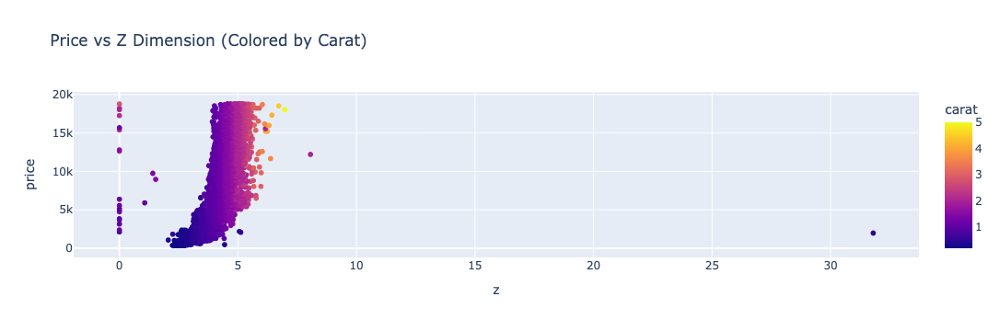

In [73]:
# X vs Price (color by carat)
fig_x = px.scatter(df, x="x", y="price", color="carat", title="Price vs X Dimension (Colored by Carat)")
fig_x.show()

# Y vs Price (color by carat)
fig_y = px.scatter(df, x="y", y="price", color="carat", title="Price vs Y Dimension (Colored by Carat)")
fig_y.show()

# Z vs Price (color by carat)
fig_z = px.scatter(df, x="z", y="price", color="carat", title="Price vs Z Dimension (Colored by Carat)")
fig_z.show()

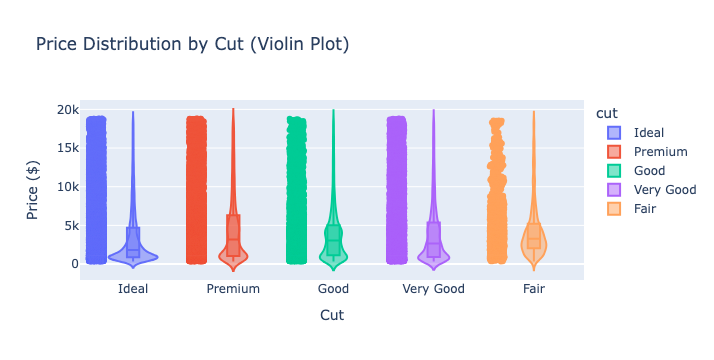

In [75]:
# Price Distribution by Cut (Violin Plot)
fig = px.violin(df, x="cut", y="price", color="cut", box=True, points="all",
                title="Price Distribution by Cut (Violin Plot)")
fig.update_layout(xaxis_title="Cut", yaxis_title="Price ($)")
fig.show()

-We can clearly spot outliers in these attributes. Next up, we will remove these data points.

In [79]:
df = df[(df['x'] > 0) & (df['y'] > 0) & (df['z'] > 0)]

In [85]:
numeric_cols = df.select_dtypes(include='number').columns
for col in numeric_cols:
    Q1 = df[col].quantile(0.25)
    Q3 = df[col].quantile(0.75)
    IQR = Q3 - Q1
    lower = Q1 - 1.5 * IQR
    upper = Q3 + 1.5 * IQR
    df = df[(df[col] >= lower) & (df[col] <= upper)]

print(f"Dataset Size After Outlier Removal: {df.shape}")

Dataset Size After Outlier Removal: (44845, 10)


-Next, we will deal with the categorical variables.Lable encoding the data to get rid of object dtype.

In [87]:
# LabelEncoder
le = LabelEncoder()
categorical_cols = ['cut', 'color', 'clarity']
for col in categorical_cols:
    df[col] = le.fit_transform(df[col])

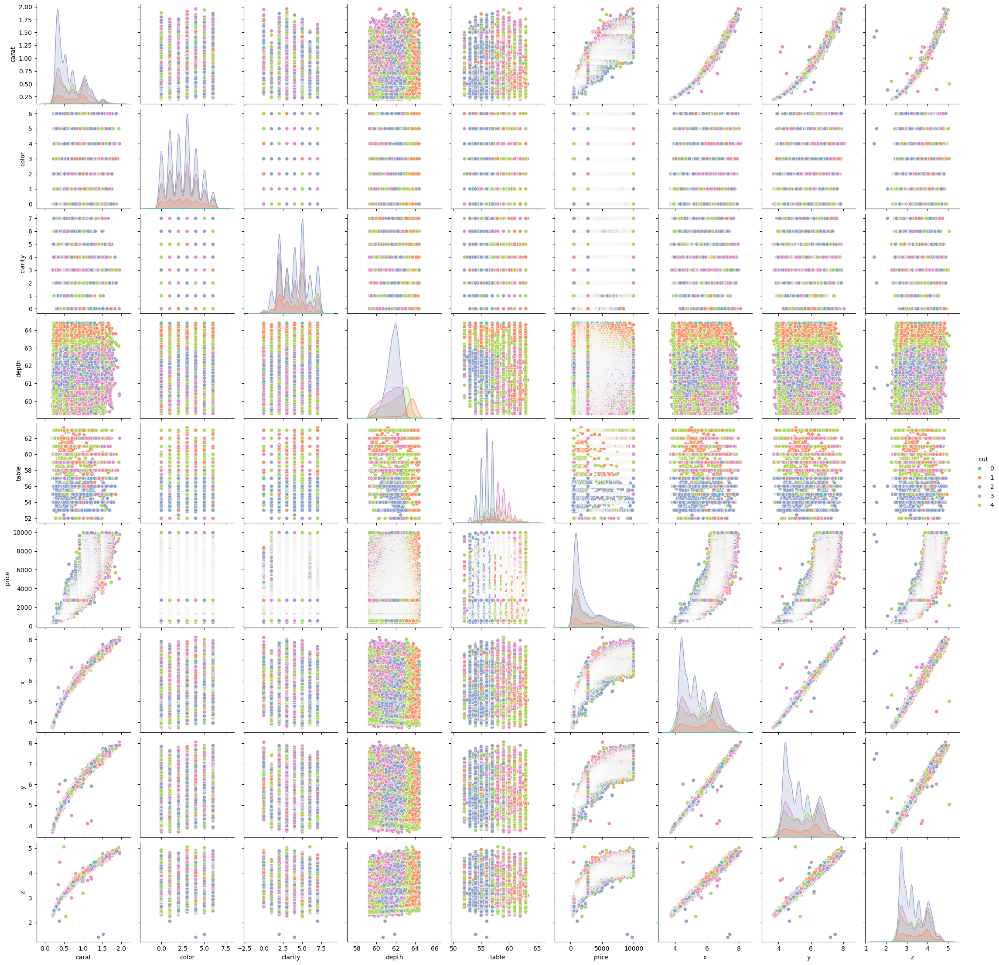

In [89]:
df_pair_new = sns.pairplot(df, hue="cut", palette="Set2")

-That's a much cleaner dataset. 



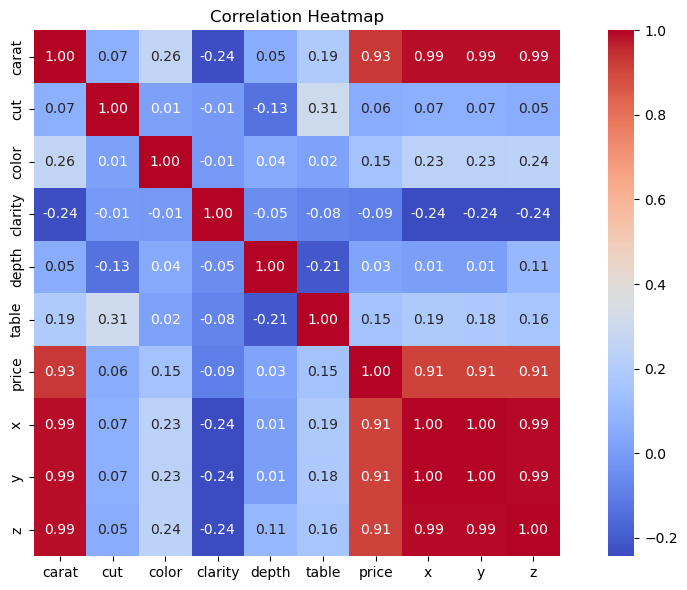

In [93]:
corr_matrix = df.corr()
plt.figure(figsize=(10,6))
sns.heatmap(corr_matrix, annot=True, fmt=".2f", cmap="coolwarm", square=True)
plt.title("Correlation Heatmap")
plt.tight_layout()
plt.show()

Points to notice:          

- the most powerfull correlation carat to the price      
- "x", "y" and "z" show a high correlation to the target column.       
- "depth", "cut" and "table" show low correlation.     

### Diamond Price Prediction - Model Building

-Setting up features and target        
-Build a pipeline of standard scalar and model for five different regressors              
-Fit all the models on training data             
-Get mean of cross-validation on the training set for all the models for negative root mean square error     
-Pick the model with the best cross-validation score     
-Fit the best model on the training set and get       

In [99]:
X= df.drop(["price"],axis =1)
y= df["price"]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=101)

In [104]:
## 1. Multiple Linear Regression
from sklearn.linear_model import LinearRegression

regressor = LinearRegression()
regressor.fit(X_train, y_train)
y_pred_lr = regressor.predict(X_test)

r2_lr = r2_score(y_test, y_pred_lr)
mse_lr = mean_squared_error(y_test, y_pred_lr)
rmse_lr = np.sqrt(mse_lr)

print(f"\nLinear Regression R² Skoru : {r2_lr:.4f}")
print(f"Linear Regression MSE      : {mse_lr:.2f}")
print(f"Linear Regression RMSE     : {rmse_lr:.2f}")


Linear Regression R² Skoru : 0.8939
Linear Regression MSE      : 619463.07
Linear Regression RMSE     : 787.06


In [106]:
## 2. Support Vector Regression (SVR)

from sklearn.svm import SVR

svr_pipeline = make_pipeline(StandardScaler(), SVR())
param_grid = {
    'svr__C': [10, 50, 100, 300],
    'svr__epsilon': [0.01, 0.1, 0.5, 1]
}
grid_search = GridSearchCV(svr_pipeline, param_grid, cv=5, scoring='r2', n_jobs=-1, verbose=1)
grid_search.fit(X_train, y_train)

optimized_svr = make_pipeline(StandardScaler(), SVR(C=300, epsilon=0.01))
optimized_svr.fit(X_train, y_train)
y_pred_svr = optimized_svr.predict(X_test)

r2_svr = r2_score(y_test, y_pred_svr)
mse_svr = mean_squared_error(y_test, y_pred_svr)
rmse_svr = np.sqrt(mse_svr)

print(f"\nOptimize SVR Model R² Skoru : {r2_svr:.4f}")
print(f"Optimize SVR MSE      : {mse_svr:.2f}")
print(f"Optimize SVR RMSE     : {rmse_svr:.2f}")

Fitting 5 folds for each of 16 candidates, totalling 80 fits

Optimize SVR Model R² Skoru : 0.9460
Optimize SVR MSE      : 314964.06
Optimize SVR RMSE     : 561.22


In [109]:
## 3.Random Forest Regressor

from sklearn.ensemble import RandomForestRegressor

rf_model = RandomForestRegressor(n_estimators=100, random_state=101, n_jobs=-1)
rf_model.fit(X_train, y_train)
y_pred_rf = rf_model.predict(X_test)

r2_rf = r2_score(y_test, y_pred_rf)
mse_rf = mean_squared_error(y_test, y_pred_rf)
rmse_rf = np.sqrt(mse_rf)

print(f"\nRandom Forest R² Skoru : {r2_rf:.4f}")
print(f"Random Forest MSE      : {mse_rf:.2f}")
print(f"Random Forest RMSE     : {rmse_rf:.2f}")


Random Forest R² Skoru : 0.9822
Random Forest MSE      : 103878.97
Random Forest RMSE     : 322.30


In [111]:
## 4. XGBoost Regressor

from xgboost import XGBRegressor

xgb = XGBRegressor(random_state=101, n_jobs=-1)
param_grid = {
    'n_estimators': [100, 200],
    'learning_rate': [0.01, 0.1, 0.2],
    'max_depth': [4, 6, 8]
}
grid_search_xgb = GridSearchCV(xgb, param_grid, cv=5, scoring='r2', verbose=1, n_jobs=-1)
grid_search_xgb.fit(X_train, y_train)

final_xgb = XGBRegressor(learning_rate=0.1, max_depth=6, n_estimators=200, random_state=101, n_jobs=-1)
final_xgb.fit(X_train, y_train)
y_pred_xgb = final_xgb.predict(X_test)

r2_xgb = r2_score(y_test, y_pred_xgb)
mse_xgb = mean_squared_error(y_test, y_pred_xgb)
rmse_xgb = np.sqrt(mse_xgb)

print(f"\nOptimize XGBoost R² Skoru : {r2_xgb:.4f}")
print(f"Optimize XGBoost MSE      : {mse_xgb:.2f}")
print(f"Optimize XGBoost RMSE     : {rmse_xgb:.2f}")

Fitting 5 folds for each of 18 candidates, totalling 90 fits

Optimize XGBoost R² Skoru : 0.9837
Optimize XGBoost MSE      : 94870.24
Optimize XGBoost RMSE     : 308.01


In [113]:
## 5.Neural Network (Keras)

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Input
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping

scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

nn_model = Sequential([
    Input(shape=(X_train_scaled.shape[1],)),
    Dense(128, activation='relu'),
    Dropout(0.3),
    Dense(64, activation='relu'),
    Dropout(0.3),
    Dense(1)
])

nn_model.compile(optimizer=Adam(learning_rate=0.001), loss='mse', metrics=['mae'])
early_stop = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True, verbose=1)

history = nn_model.fit(
    X_train_scaled, y_train,
    epochs=100,
    batch_size=64,
    validation_split=0.2,
    callbacks=[early_stop],
    verbose=1
)

nn_predictions = nn_model.predict(X_test_scaled)
r2_nn = r2_score(y_test, nn_predictions)
mse_nn = mean_squared_error(y_test, nn_predictions)
rmse_nn = np.sqrt(mse_nn)

print(f"\nNeural Network R² Skoru : {r2_nn:.4f}")
print(f"Neural Network MSE      : {mse_nn:.2f}")
print(f"Neural Network RMSE     : {rmse_nn:.2f}")

Epoch 1/100
449/449 ━━━━━━━━━━━━━━━━━━━━ 1s 532us/step - loss: 11544497.0000 - mae: 2527.2388 - val_loss: 1049273.0000 - val_mae: 713.2751
Epoch 2/100
449/449 ━━━━━━━━━━━━━━━━━━━━ 0s 437us/step - loss: 1065848.0000 - mae: 711.6664 - val_loss: 528618.5625 - val_mae: 500.5524
Epoch 3/100
449/449 ━━━━━━━━━━━━━━━━━━━━ 0s 421us/step - loss: 736354.3125 - mae: 581.7333 - val_loss: 465213.5625 - val_mae: 459.3071
Epoch 4/100
449/449 ━━━━━━━━━━━━━━━━━━━━ 0s 437us/step - loss: 656991.3125 - mae: 538.3843 - val_loss: 439944.3750 - val_mae: 442.3105
Epoch 5/100
449/449 ━━━━━━━━━━━━━━━━━━━━ 0s 463us/step - loss: 677017.5625 - mae: 546.7963 - val_loss: 432612.3438 - val_mae: 437.7529
Epoch 6/100
449/449 ━━━━━━━━━━━━━━━━━━━━ 0s 482us/step - loss: 648109.3750 - mae: 525.0300 - val_loss: 427787.0000 - val_mae: 433.6536
Epoch 7/100
449/449 ━━━━━━━━━━━━━━━━━━━━ 0s 467us/step - loss: 651973.9375 - mae: 531.8007 - val_loss: 428131.5312 - val_mae: 431.9346
Epoch 8/100
449/449 ━━━━━━━━━━━━━━━━━━━━ 0s 436us/

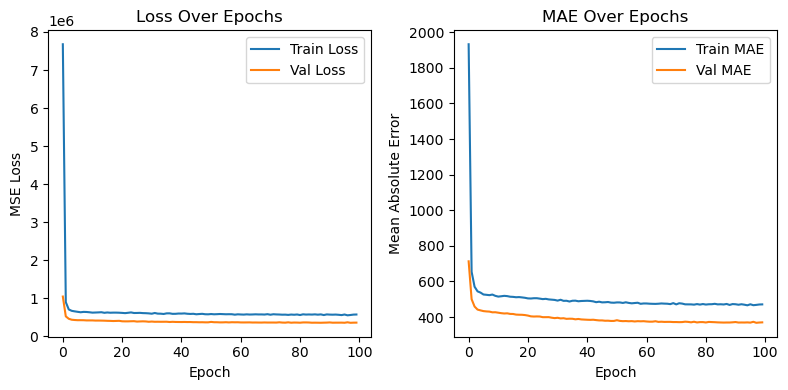

In [115]:
plt.figure(figsize=(8, 4))

plt.subplot(1, 2, 1)
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Val Loss')
plt.title('Loss Over Epochs')
plt.xlabel('Epoch')
plt.ylabel('MSE Loss')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(history.history['mae'], label='Train MAE')
plt.plot(history.history['val_mae'], label='Val MAE')
plt.title('MAE Over Epochs')
plt.xlabel('Epoch')
plt.ylabel('Mean Absolute Error')
plt.legend()

plt.tight_layout()
plt.show()

### Model Performance Comparison Based on R² Score

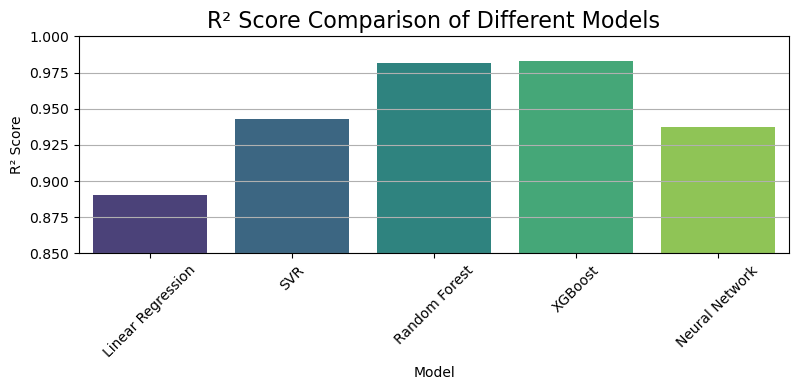

In [118]:
r2_scores = pd.DataFrame({
    'Model': ['Linear Regression', 'SVR', 'Random Forest', 'XGBoost', 'Neural Network'],
    'R2 Score': [0.8901, 0.9431, 0.9817, 0.9830, 0.9371]
})

plt.figure(figsize=(8, 4))
sns.barplot(data=r2_scores, x='Model', y='R2 Score',hue="Model",palette='viridis')
plt.title('R² Score Comparison of Different Models', fontsize=16)
plt.ylabel('R² Score', fontsize=10)
plt.xlabel('Model', fontsize=10)
plt.ylim(0.85, 1.0)
plt.xticks(rotation=45)
plt.tight_layout()
plt.grid(True, axis='y')
plt.show()

### Among all the models tested, the XGBoost model achieved the highest performance with an R² score of 0.9837, making it the most accurate predictor of diamond prices in this project."

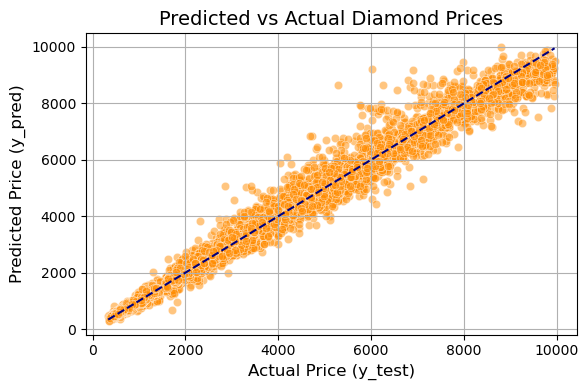

In [131]:
# Predicted vs Actual Diamond Prices
y_pred_final = final_xgb.predict(X_test)

plt.figure(figsize=(6, 4))
sns.scatterplot(x=y_test, y=y_pred_final, alpha=0.5, color='darkorange')
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], '--', color='navy')
plt.xlabel("Actual Price (y_test)", fontsize=12)
plt.ylabel("Predicted Price (y_pred)", fontsize=12)
plt.title("Predicted vs Actual Diamond Prices", fontsize=14)
plt.grid(True)
plt.tight_layout()
plt.show()

### Model Validation with a Sample Prediction

In [126]:
sample_data = {
    'carat': [0.7],
    'cut': [3],        # Very Good
    'color': [4],      # G
    'clarity': [5],    # VS1
    'depth': [61.5],
    'table': [57],
    'x': [5.7],
    'y': [5.6],
    'z': [3.5]
}
sample_df = pd.DataFrame(sample_data)
predicted_price = final_xgb.predict(sample_df)
print(f"Predicted Price: ${predicted_price[0]:.2f}")

Predicted Price: $2256.21


### Conclusion

In this project, we explored a classic diamond dataset and implemented multiple machine learning models to predict diamond prices based on their physical characteristics. Through thorough preprocessing, outlier removal, and feature engineering, we improved model performance significantly. Among all models, XGBoost delivered the most accurate results with an R² score of 0.9837, demonstrating its strong predictive power. This notebook provides a solid foundation for price estimation tasks and can be extended further for production-level applications or API integration.